In [1]:
from Common_functions import  *

%matplotlib inline

In [2]:
import glob,os,sys
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from numpy import *
import re
from tqdm import tqdm
from matplotlib.lines import Line2D
from matplotlib.patches import Patch
import scipy.stats as st
from os.path import expanduser
import cmath
from scipy import optimize
import time
import gzip
from scipy.interpolate import interp1d
import pandas as pd
from scipy.interpolate import interp1d
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes
from mpl_toolkits.axes_grid1.inset_locator import (mark_inset,inset_axes,InsetPosition) 
import traceback
from lmfit import minimize, Parameters, Parameter, report_fit
import matplotlib.patches as patches
from sympy.solvers import solve
from sympy import Symbol
import sympy


%matplotlib inline
home = os.path.expanduser("~")

In [3]:
# Path to the larger dataset
home = os.path.expanduser("~")

temp = home+'/Library/Mobile Documents/com~apple~CloudDocs/Microlensing_Data_Challeng/data-challenge-1/alldclc/'#lc/'
direc = os.listdir(temp)

In [4]:
def med_med (true,fitted):
    temp = fitted - true
    return (np.median(np.abs(temp-np.median(temp))))

In [5]:
def cal_chisqr(model, fx, ferr):
    
    
    return np.sum(((fx-model)**2)/((ferr)**2))

In [6]:
def Calculate_PSPL_minus_Cauchy (t, m, e):
    
    
    
    df, baseline, event, it0, dt = prepare(t,m,e)


    A_max = df['A'][np.argmin(m[m>np.percentile(m, [0.0,100])[0]])] #np.max(df['A']) #1.0/(float(f_s_true)/(max(df['f'])-1+float(f_s_true)))
#     u0_true = np.sqrt( ( (1+np.sqrt(1+16*(A_max**2)))/(2* A_max) ) - 2 )
    t0_true =  df['t'][np.argmin(m[m>np.percentile(m, [0.0,100])[0]])] #it0 #t[A.argmax()] #float(t0_theo)
    amp_ini =  df.A[it0] - np.median(df.A[baseline])
    tE_true = [0.01, 0.1, 1.0, 10.0, 100]
    
    fs_true = 0.5
    if A_max > 1:
        u0 = Symbol('u0')
        solve_u0 = (solve((2+u0**2)/(u0*sympy.sqrt(4+u0**2))-((A_max-(1-fs_true))/fs_true), u0))

        u0_true = np.array(solve_u0[0], dtype=np.float64)
    else:
        u0_true = np.sqrt( ( (1+np.sqrt(1+16*(A_max**2)))/(2* A_max) ) - 2 )
        


    
    #################################
    
    temp_PSPL = [[], []]
    for tE in tE_true:

        params2 = Parameters()
        params2.add('t0', value= t0_true, min=min(df['t']), max=max(df['t']))
        params2.add('tE', value= tE, min=0.001, max=1000)
        params2.add('u0', value= u0_true, min=0, max=5)
    #     params2.add('base', value= np.median(lightcurve[baseline,1]), min=max((lightcurve[baseline,1])), max=min((lightcurve[baseline,1])))
        params2.add('fs', value= fs_true, min=0, max=1)
    #             params2.add('fb', value= 0.5, min=0, max=1)


        res2 = minimize(PSPL_data, params2, args=(df['t'].values, df['A'].values))

        temp_PSPL[0].append(res2.params)
        temp_PSPL[1].append(res2.chisqr)

    result2 = temp_PSPL[0][np.argmin(temp_PSPL[1])]

    PSPL_A = PSPL(result2['t0'], result2['tE'], result2['u0'], result2['fs'] , df['t'])
    
    c = 10*result2['tE']*result2['u0']
#     A_top_temp = df['A'][(df.t < result2['t0'] + c) & (df.t > result2['t0'] - c)]
#     if (len(A_top_temp)<5):
#         c = c*2
        
    
#     A_top_temp = df['A'][(df.t < result2['t0'] + c) & (df.t > result2['t0'] - c)]
    
#     while (len(A_top_temp)<10):
        
#         c = c*2
# #         A_top_temp = df['A'][(df.t < result2['t0'] + c) & (df.t > result2['t0'] - c)]



    t_top = df['t'][(df.t < result2['t0'] + c) & (df.t > result2['t0'] - c)]
    A_top = df['A'][(df.t < result2['t0'] + c) & (df.t > result2['t0'] - c)]
    model_top = PSPL_A[(df.t < result2['t0'] + c) & (df.t > result2['t0'] - c)]
    A_err_top = df['A_err'][(df.t < result2['t0'] + c) & (df.t > result2['t0'] - c)]

    chisqr_PSPL = np.sum((df['A'].values-PSPL_A)**2)

    chisqr_PSPL_err = cal_chisqr(PSPL_A, df['A'].values, df['A_err'].values)
    chisqr_PSPL_top = cal_chisqr(model_top, A_top.values, A_err_top.values)
    chisqr_PSPL_top_reduced = chisqr_PSPL_top/len(model_top)
    
    ##################################
    temp_bell = [[], []]
    for tE in tE_true:
        params = Parameters()
        params.add('t0', value= result2['t0'], min=result2['t0']-100, max=result2['t0']+100)
        params.add('tE', value= tE, min=0.0001, max=1000)
        params.add('b', value= 1, min=0, max=20)
        params.add('amp', value= A_max, min=0, max=1000)


        res1 = minimize(bell_curve_data, params, args=(df['t'].values, df.A ))
        temp_bell[0].append(res1.params)
        temp_bell[1].append(res1.chisqr)

    result1 = temp_bell[0][np.argmin(temp_bell[1])]
    bellcurve_A = bell_curve(df.t, result1['t0'], result1['tE'] ,result1['b'], result1['amp'])




    A_top = df['A'][(df.t < result2['t0'] + c) & (df.t > result2['t0'] - c)]
    model_top = bellcurve_A[(df.t < result2['t0'] + c) & (df.t > result2['t0'] - c)]
    A_err_top = df['A_err'][(df.t < result2['t0'] + c) & (df.t > result2['t0'] - c)]

    chisqr_bell = np.sum((df['A'].values-bellcurve_A)**2)
    chisqr_bell_err = cal_chisqr(bellcurve_A, df['A'].values, df['A_err'].values)
    chisqr_bell_top = cal_chisqr(model_top, A_top.values, A_err_top.values)
    chisqr_bell_top_reduced = chisqr_bell_top/(len(model_top))


    
    #################################
    
    topright_len = len(A_top[t_top>result2['t0']])
    topleft_len = len(A_top[t_top<result2['t0']])
    
    return df, baseline, event, topright_len, topleft_len, result1, result2, chisqr_bell, chisqr_bell_err, chisqr_PSPL,\
            chisqr_PSPL_err, chisqr_bell_top, chisqr_PSPL_top, chisqr_bell_top_reduced, chisqr_PSPL_top_reduced
    

In [32]:
info = pd.read_csv('test_result/Cauchy/Cauchy_PSPL_results_V3.CSV')

In [33]:
info_selected = info[ (info.rho_u0_ratio<0.01) & (info.delta_chisqr_top_reduced<0) & (info.top_number>3)]
info_selected = info_selected.drop(['level_0','index', 'Unnamed: 0', 'Unnamed: 0.1','Unnamed: 0.1.1','Unnamed: 0.1.1.1'], axis=1)
info_selected = info_selected.reset_index()

100%|██████████| 372/372 [20:34<00:00,  3.32s/it]


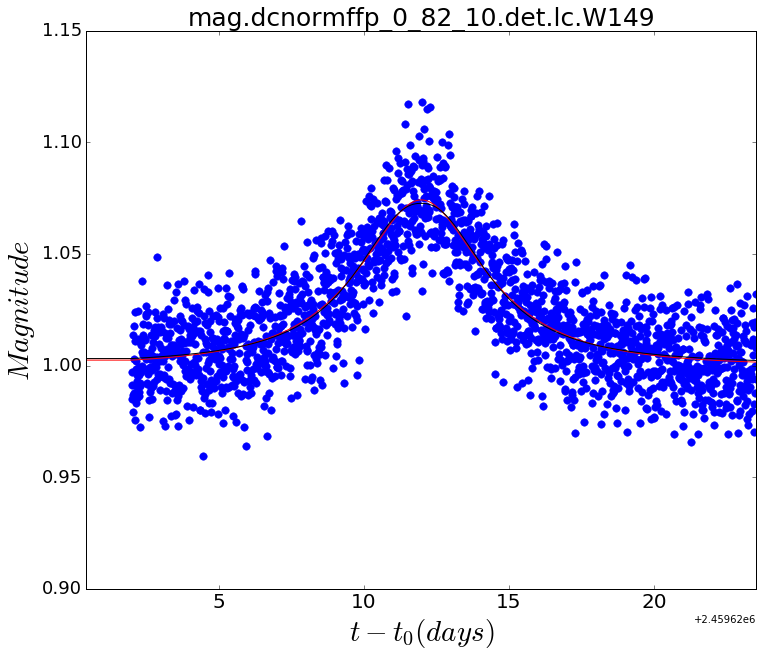

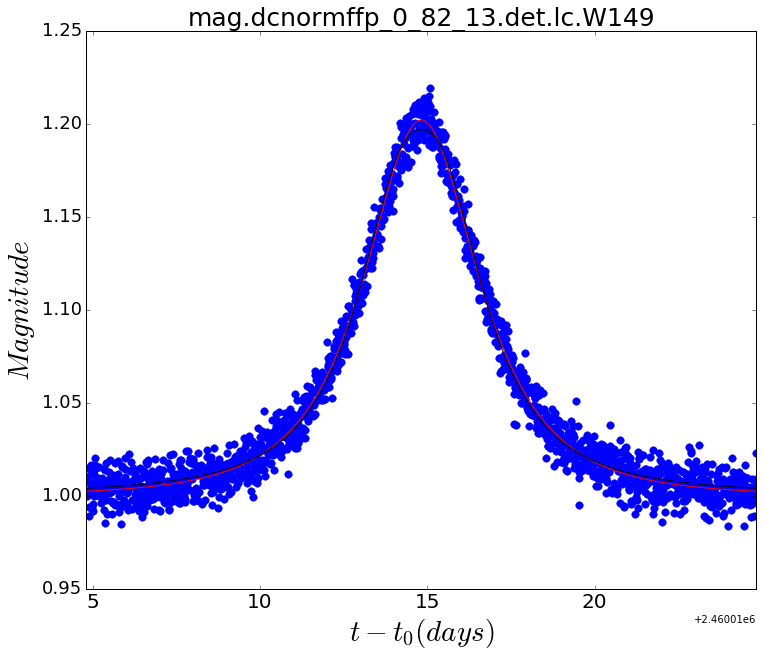

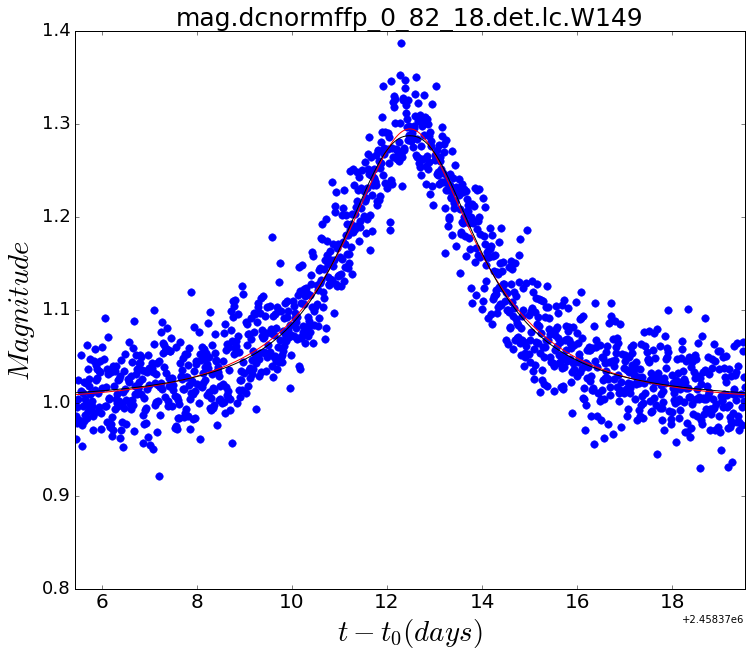

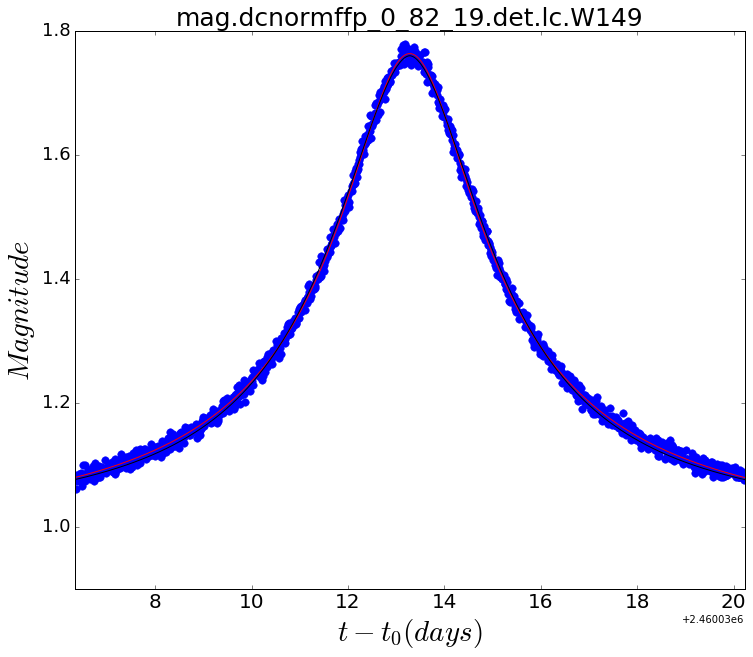

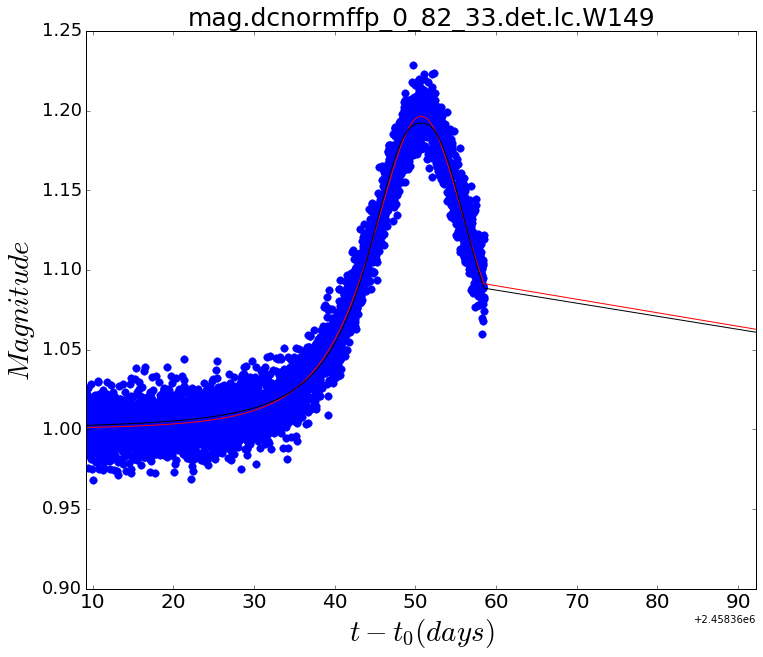

...

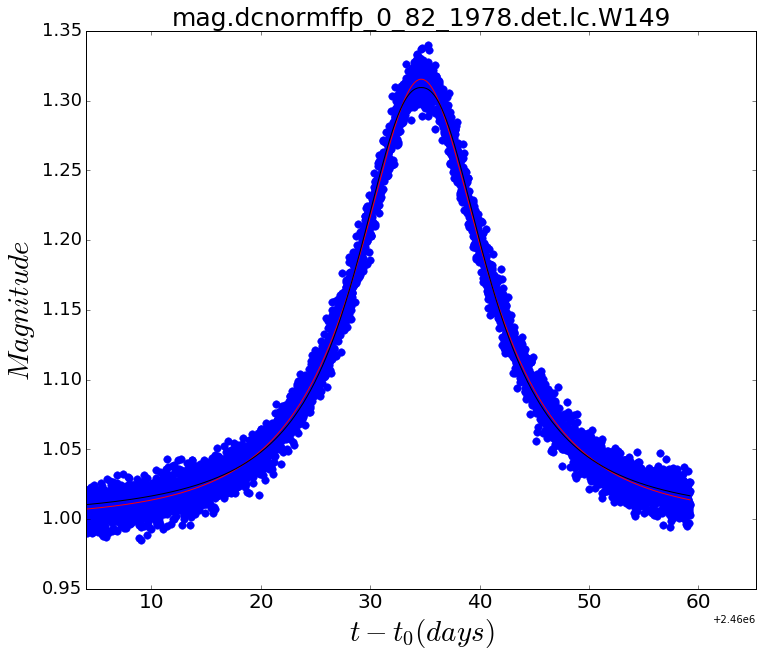

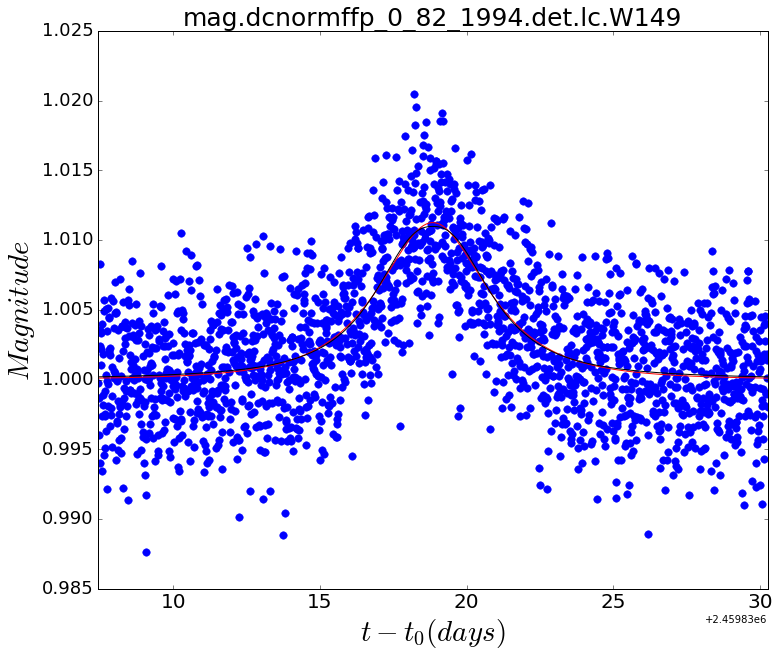

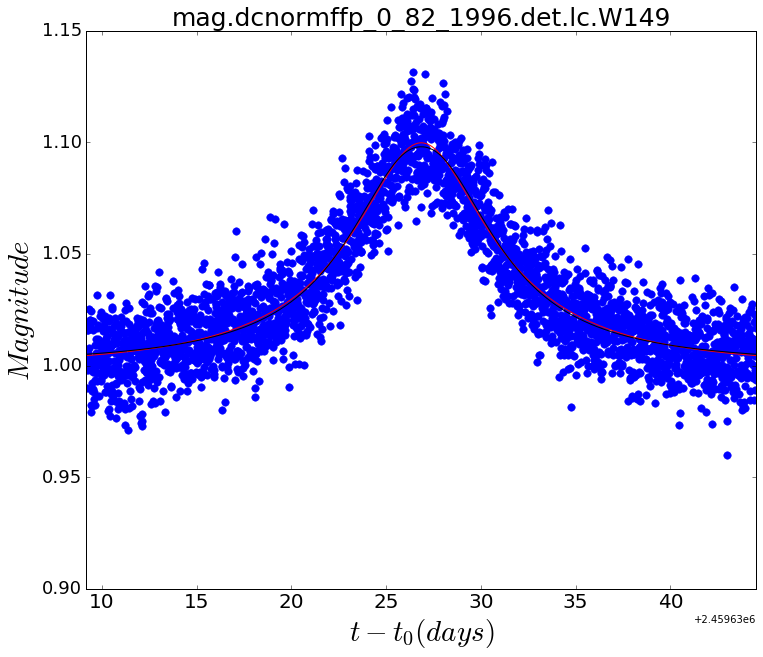

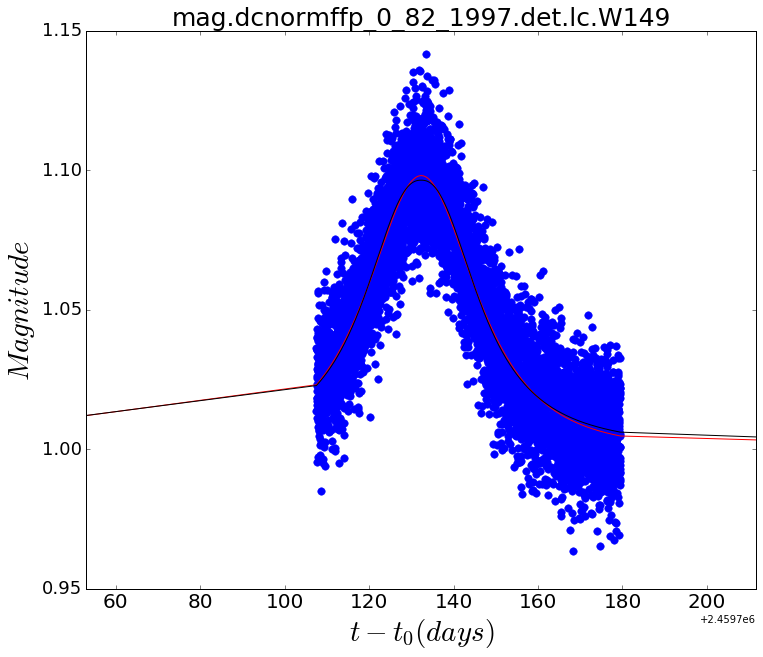

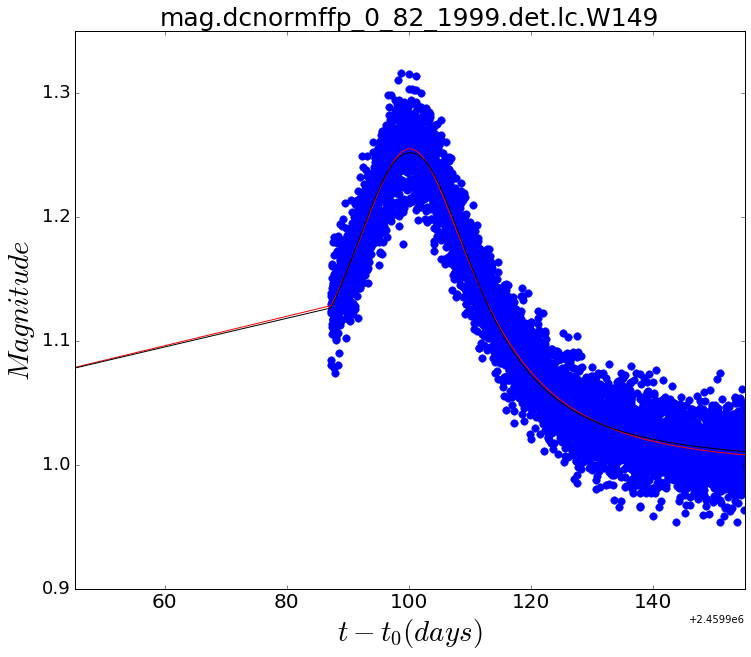

In [34]:
for i in tqdm(range(len(info_selected.name))):
    
    t,m,e = np.loadtxt(temp+str(info_selected.name[i]),unpack=True, usecols=(0,1, 2))
    
    df, baseline, event, topright_len, topleft_len,result1, result2, chisqr_bell, chisqr_bell_err,\
    chisqr_PSPL, chisqr_PSPL_err, chisqr_bell_top, chisqr_PSPL_top,\
    chisqr_bell_top_reduced, chisqr_PSPL_top_reduced = Calculate_PSPL_minus_Cauchy(t, m, e)
    
    dtt = 5*result2['tE']*result2['u0']

    PSPL_A = PSPL(result2['t0'],result2['tE'],result2['u0'],
                  result2['fs'], df['t'])
    bellcurve_A = bell_curve(df['t'], result1['t0'].value, 
                                      result1['tE'].value, 
                                      result1['b'].value,
                                      result1['amp'].value)
    
    plt.figure()
    plt.title(str(info_selected.name[i]), size=25)
    plt.xlabel('$t - t_0 (days)$',size=29)
    plt.ylabel('$Magnitude$',size=29)
    plt.tick_params(axis='y',labelsize=18)
    plt.tick_params(axis='x',labelsize=20)
    plt.plot(df['t'], df['A'], 'b.', markersize=15)
    plt.plot(df['t'], PSPL_A, 'r-')
    plt.plot(df['t'], bellcurve_A, 'k-')
    plt.xlim(result2['t0'].value-dtt, result2['t0'].value+dtt)
    fig = plt.gcf()
    fig.set_size_inches(12.0,10.0)
    fig.savefig('test_result/Cauchy/Plots/psi<0/psi<0_rho:u0<0.01/'+str(info_selected.name[i])+'.png')